# July 23 - Dimensionality reduction on latent vectors

## Goal : Using PCA to apply dimensionality reduction on the latent vectors

In [6]:
# Imports
import math
import os
import sys
import pandas as pd
import numpy as np

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from mpl_toolkits.mplot3d import Axes3D

# Add the path to the parent directory to augment search for module
par_dir = os.path.abspath(os.path.join(os.getcwd(), os.pardir))
if par_dir not in sys.path:
    sys.path.append(par_dir)
    
# Import the custom plotting module
from plot_utils import plot_utils
import random

# Label dict - Dictionary mapping integer labels to str
label_dict = {0:"gamma", 1:"e", 2:"mu"}

## Using a smaller dataset of 10000 samples for inital methods

In [7]:
run_id = "20190622_215251"
dump_dir = "/home/akajal/WatChMaL/VAE/dumps/" + run_id + "/"

# Load the arrays from the disk
pre_train_npz = np.load(dump_dir + "pre_train_latent.npz")
post_train_npz = np.load(dump_dir + "post_train_latent.npz")

pre_valid_npz = np.load(dump_dir + "pre_valid_latent.npz")
post_valid_npz = np.load(dump_dir + "post_valid_latent.npz")

In [8]:
# Import the method to perform PCA
from sklearn.decomposition import PCA

## Perform PCA on the pre-training latent vectors over the training dataset

In [9]:
# Using only 1 principle component
pca_1 = PCA(n_components=1)
pca_1.fit(pre_train_npz['latents'])


PCA(copy=True, iterated_power='auto', n_components=1, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

In [10]:
# Print the attributes of the pca fitter
print("Components : {0}".format(pca_1.components_))
print("Explained variance : {0}".format(pca_1.explained_variance_))
print("Explained variance ratio : {0}".format(pca_1.explained_variance_ratio_))

Components : [[-0.03364728  0.01913276  0.03984918  0.1372312   0.11655215 -0.10970417
  -0.27016178 -0.0866007   0.09731059  0.09459183 -0.19582626 -0.00218504
   0.18456043  0.13806026 -0.12832658 -0.047554    0.04630165  0.10926832
  -0.12157321  0.17077912  0.12546152  0.02905214 -0.14516757  0.2915024
   0.05608297  0.14204776  0.03941307 -0.07684342 -0.06093771  0.00880505
  -0.14317445 -0.10865664  0.04743221 -0.13423152  0.17123358 -0.25143754
  -0.09682496  0.25050652  0.05915551 -0.09706513  0.24143371 -0.08040586
  -0.02811702  0.10943562  0.14681621 -0.07279947  0.13967441 -0.10826369
   0.06215388  0.11084977  0.16627052  0.06587205 -0.11259613  0.0328481
  -0.17225052  0.03831724 -0.03746787  0.00954486  0.12530059 -0.0579057
   0.18888299  0.02417909 -0.05426091  0.0977933 ]]
Explained variance : [0.00349408]
Explained variance ratio : [0.05350323]


In [11]:
# Transform the vectors
pre_train_npz_latent = pre_train_npz['latents']
pre_train_npz_latent = pca_1.fit_transform(pre_train_npz_latent)

In [12]:
print(pre_train_npz['latents'].shape)
print(pre_train_npz_latent.shape)

(240000, 64)
(240000, 1)


In [13]:
# Using 2 principle components
pca_2 = PCA(n_components=2)
pre_train_npz_latent = pre_train_npz['latents']
pre_train_npz_latent = pca_2.fit_transform(pre_train_npz_latent)

print(pre_train_npz['latents'].shape)
print(pre_train_npz_latent.shape)

(240000, 64)
(240000, 2)


## Plotting a scatter plot of the dimensionality reduced representation of the latent vectors for each class

In [14]:
# Get the labels from the npz dict
pre_train_npz_labels = pre_train_npz['labels']
print(pre_train_npz_labels.shape)

(240000,)


In [15]:
curr_event_latents = pre_train_npz_latent[pre_train_npz_labels == 1]
print(curr_event_latents[0].shape)

(2,)


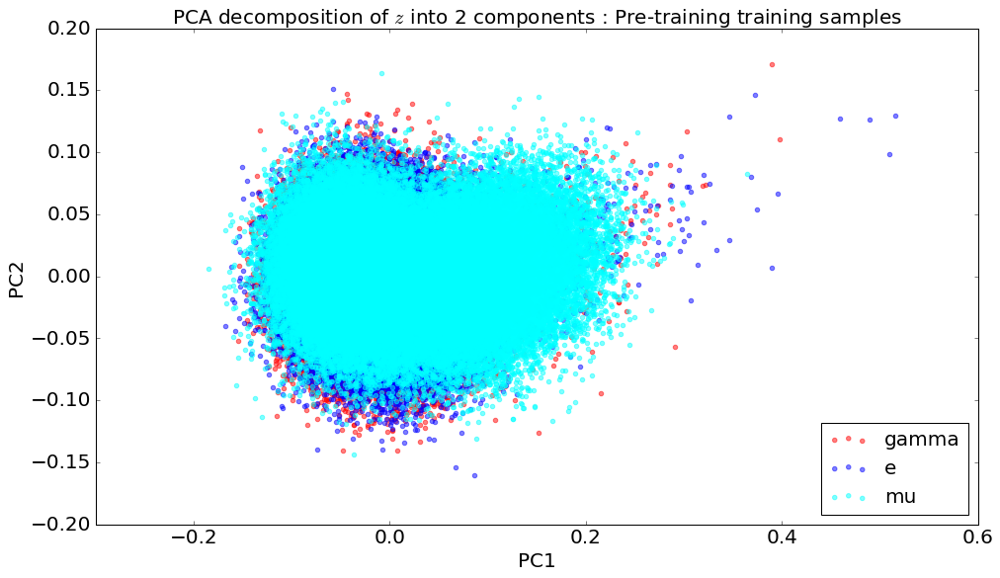

In [16]:
# Initialize the plot and corresponding parameters
fig, ax = plt.subplots(figsize=(16,9),facecolor="w")
ax.tick_params(axis="both", labelsize=20)

colors = ["red", "blue", "cyan"]

for i in range(len(colors)):
    curr_event_latents = pre_train_npz_latent[pre_train_npz_labels == i]
    plt.scatter(curr_event_latents[:,0], curr_event_latents[:,1], color=colors[i],
               label=label_dict[i], alpha=0.5)

# Setup the axes
ax.set_xlabel("PC1", fontsize=20)
ax.set_ylabel("PC2", fontsize=20)

plt.legend(loc="lower right", prop={"size":20})
plt.title(r"PCA decomposition of $z$ into 2 components : Pre-training training samples"
          ,fontsize=20)

plt.show()

In [19]:
print(pca_2.explained_variance_ratio_)

[0.05350319 0.01705602]


## Doing the same procedure for post-training latent vectors

Latents vector shape (240000, 64)
Principal components shape  (240000, 2)
Labels vector shape  (240000,)


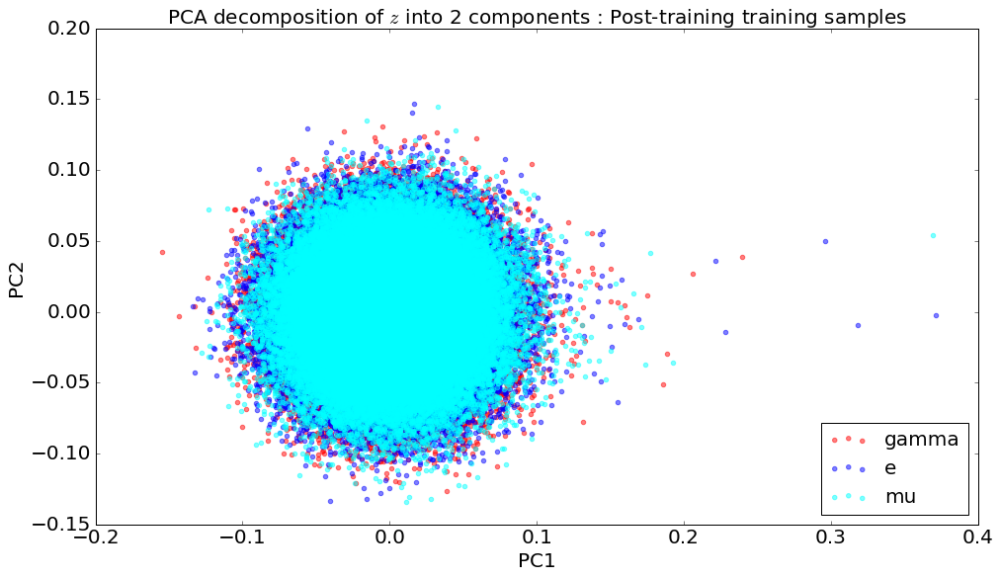

In [21]:
# Using 2 principle components
pca_post_train_2 = PCA(n_components=2)
post_train_npz_latent = post_train_npz['latents']
post_train_npz_latent = pca_2.fit_transform(post_train_npz_latent)

print("Latents vector shape", post_train_npz['latents'].shape)
print("Principal components shape ", post_train_npz_latent.shape)

# Get the labels from the npz dict
post_train_npz_labels = pre_train_npz['labels']
print("Labels vector shape ", post_train_npz_labels.shape)

# Initialize the plot and corresponding parameters
fig, ax = plt.subplots(figsize=(16,9),facecolor="w")
ax.tick_params(axis="both", labelsize=20)

colors = ["red", "blue", "cyan"]

for i in range(len(colors)):
    curr_event_latents = post_train_npz_latent[post_train_npz_labels == i]
    plt.scatter(curr_event_latents[:,0], curr_event_latents[:,1], color=colors[i],
               label=label_dict[i], alpha=0.5)

# Setup the axes
ax.set_xlabel("PC1", fontsize=20)
ax.set_ylabel("PC2", fontsize=20)

plt.legend(loc="lower right", prop={"size":20})
plt.title(r"PCA decomposition of $z$ into 2 components : Post-training training samples"
          ,fontsize=20)

plt.show()

In [22]:
print(pca_post_train_2.explained_variance_ratio_)

AttributeError: 'PCA' object has no attribute 'explained_variance_ratio_'

## The PCA decomposition for the latent vectors show that the two principal components of the latent vectors represent a 2d Gaussian distribution.

Latents vector shape (30000, 64)
Principal components shape  (30000, 2)
Labels vector shape  (30000,)


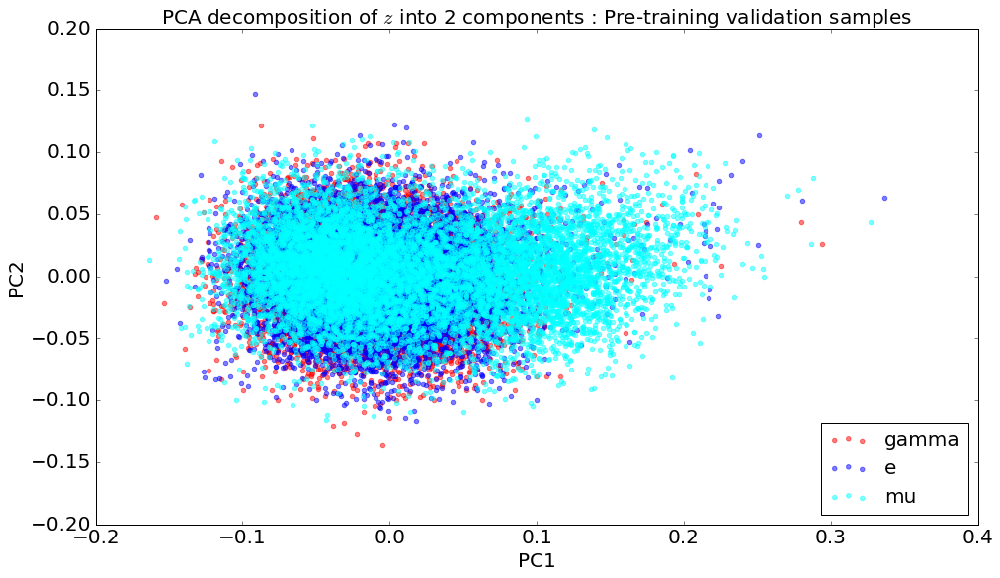

In [40]:
# Using 2 principle components
pca_pre_valid_2 = PCA(n_components=2)
pre_valid_npz_latent = pre_valid_npz['latents']
pre_valid_npz_latent = pca_2.fit_transform(pre_valid_npz_latent)

print("Latents vector shape", pre_valid_npz['latents'].shape)
print("Principal components shape ", pre_valid_npz_latent.shape)

# Get the labels from the npz dict
pre_valid_npz_labels = pre_valid_npz['labels']
print("Labels vector shape ", pre_valid_npz_labels.shape)

# Initialize the plot and corresponding parameters
fig, ax = plt.subplots(figsize=(16,9),facecolor="w")
ax.tick_params(axis="both", labelsize=20)

colors = ["red", "blue", "cyan"]

for i in range(len(colors)):
    curr_event_latents = pre_valid_npz_latent[pre_valid_npz_labels == i]
    plt.scatter(curr_event_latents[:,0], curr_event_latents[:,1], color=colors[i],
               label=label_dict[i], alpha=0.5)

# Setup the axes
ax.set_xlabel("PC1", fontsize=20)
ax.set_ylabel("PC2", fontsize=20)

plt.legend(loc="lower right", prop={"size":20})
plt.title(r"PCA decomposition of $z$ into 2 components : Pre-training validation samples"
          ,fontsize=20)

plt.show()

Latents vector shape (30000, 64)
Principal components shape  (30000, 2)
Labels vector shape  (30000,)


<function matplotlib.pyplot.show(*args, **kw)>

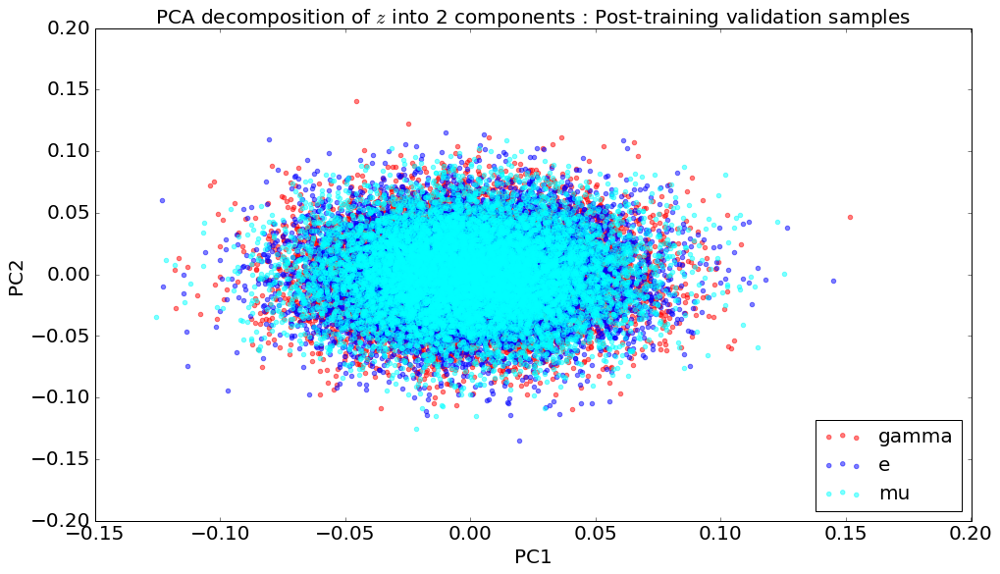

In [39]:
# Using 2 principle components
pca_post_valid_2 = PCA(n_components=2)
post_valid_npz_latent = post_valid_npz['latents']
post_valid_npz_latent = pca_2.fit_transform(post_valid_npz_latent)

print("Latents vector shape", post_valid_npz['latents'].shape)
print("Principal components shape ", post_valid_npz_latent.shape)

# Get the labels from the npz dict
post_valid_npz_labels = pre_valid_npz['labels']
print("Labels vector shape ", post_valid_npz_labels.shape)

# Initialize the plot and corresponding parameters
fig, ax = plt.subplots(figsize=(16,9),facecolor="w")
ax.tick_params(axis="both", labelsize=20)

colors = ["red", "blue", "cyan"]

for i in range(len(colors)):
    curr_event_latents = post_valid_npz_latent[post_valid_npz_labels == i]
    plt.scatter(curr_event_latents[:,0], curr_event_latents[:,1], color=colors[i],
               label=label_dict[i], alpha=0.5)

# Setup the axes
ax.set_xlabel("PC1", fontsize=20)
ax.set_ylabel("PC2", fontsize=20)

plt.legend(loc="lower right", prop={"size":20})
plt.title(r"PCA decomposition of $z$ into 2 components : Post-training validation samples"
          ,fontsize=20)

plt.show()

## Repeating the above procedure but now using 3d principle components

## Since matplotlib does not produce interactive 3d plots, switching to plotly

In [56]:
from plotly.offline import init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

import plotly.graph_objs as go

In [57]:
# Using 3 principle components
pca_pre_train_3 = PCA(n_components=3)
pre_train_npz_latent = pre_train_npz['latents']
pre_train_npz_latent = pca_pre_train_3.fit_transform(pre_train_npz_latent)

print("Latents vector shape", pre_train_npz['latents'].shape)
print("Principal components shape ", pre_train_npz_latent.shape)

# Get the labels from the npz dict
pre_train_npz_labels = pre_train_npz['labels']
print("Labels vector shape ", pre_train_npz_labels.shape)

colors = ["red", "blue", "cyan"]
scatters = []

for i in range(len(colors)):
    curr_event_latents = pre_train_npz_latent[pre_train_npz_labels == i]
    scatters.append(go.Scatter3d(
                    x=curr_event_latents[:,0],
                    y=curr_event_latents[:,1],
                    z=curr_event_latents[:,2],
                    mode='markers',
                    marker=dict(color=colors[i],
                                size=1,
                                symbol='circle',
                                opacity=0.5)))
    
fig = go.Figure(data=scatters)
iplot(fig)

Latents vector shape (240000, 64)
Principal components shape  (240000, 3)
Labels vector shape  (240000,)


## Using matplotlib and axes3d

Latents vector shape (240000, 64)
Principal components shape  (240000, 3)
Labels vector shape  (240000,)


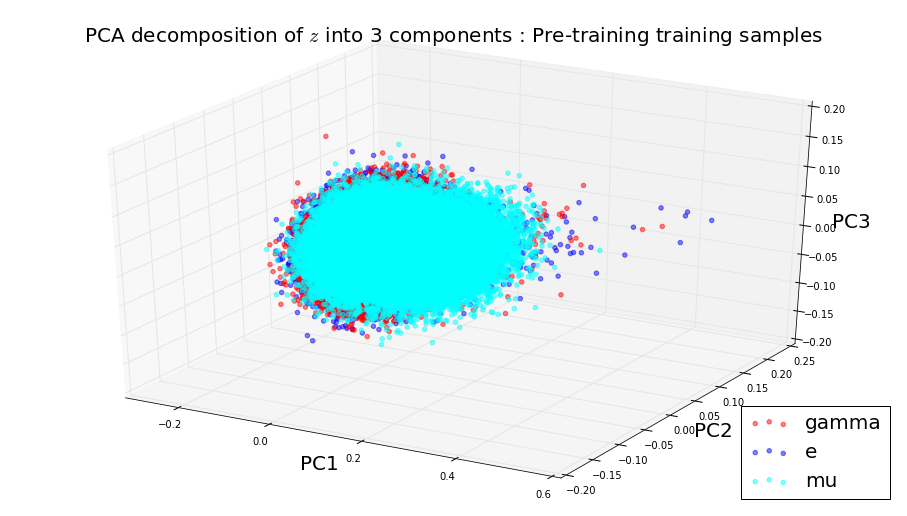

In [49]:
# Using 3 principle components
pca_pre_train_3 = PCA(n_components=3)
pre_train_npz_latent = pre_train_npz['latents']
pre_train_npz_latent = pca_pre_train_3.fit_transform(pre_train_npz_latent)

print("Latents vector shape", pre_train_npz['latents'].shape)
print("Principal components shape ", pre_train_npz_latent.shape)

# Get the labels from the npz dict
pre_train_npz_labels = pre_train_npz['labels']
print("Labels vector shape ", pre_train_npz_labels.shape)

# Initialize the plot and corresponding parameters
fig = plt.figure(figsize=(16,9),facecolor="w")
ax = fig.add_subplot(111, projection='3d')

ax.tick_params(labelsize=10)

colors = ["red", "blue", "cyan"]

for i in range(len(colors)):
    curr_event_latents = pre_train_npz_latent[pre_train_npz_labels == i]
    ax.scatter(curr_event_latents[:,0], curr_event_latents[:,1], curr_event_latents[:,2],
                color=colors[i], label=label_dict[i], alpha=0.5)

# Setup the axes
ax.set_xlabel("PC1", fontsize=20)
ax.set_ylabel("PC2", fontsize=20)
ax.set_zlabel("PC3", fontsize=20)

plt.legend(loc="lower right", prop={"size":20})
plt.title(r"PCA decomposition of $z$ into 3 components : Pre-training training samples"
          ,fontsize=20)

plt.show()

Latents vector shape (240000, 64)
Principal components shape  (240000, 3)
Labels vector shape  (240000,)


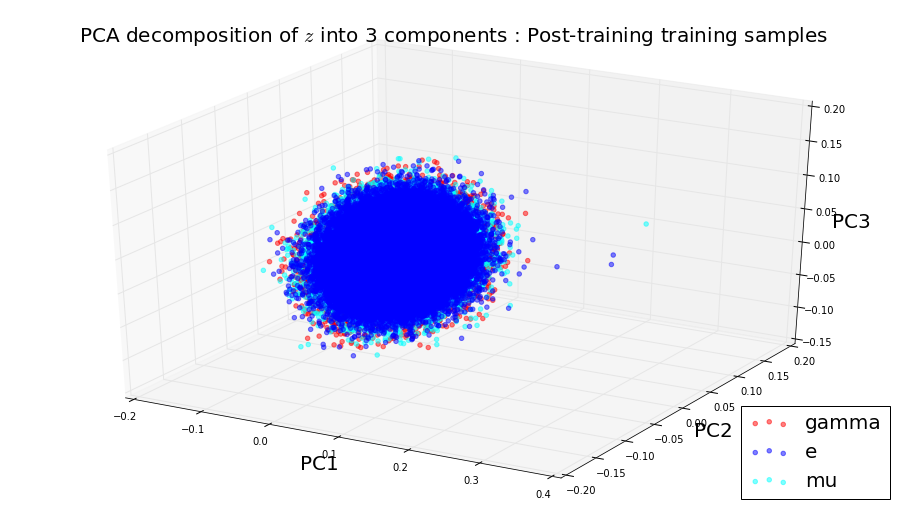

In [50]:
# Using 3 principle components
pca_post_train_3 = PCA(n_components=3)
post_train_npz_latent = post_train_npz['latents']
post_train_npz_latent = pca_post_train_3.fit_transform(post_train_npz_latent)

print("Latents vector shape", post_train_npz['latents'].shape)
print("Principal components shape ", post_train_npz_latent.shape)

# Get the labels from the npz dict
post_train_npz_labels = post_train_npz['labels']
print("Labels vector shape ", post_train_npz_labels.shape)

# Initialize the plot and corresponding parameters
fig = plt.figure(figsize=(16,9),facecolor="w")
ax = fig.add_subplot(111, projection='3d')

ax.tick_params(labelsize=10)

colors = ["red", "blue", "cyan"]

for i in range(len(colors)):
    curr_event_latents = post_train_npz_latent[pre_train_npz_labels == i]
    ax.scatter(curr_event_latents[:,0], curr_event_latents[:,1], curr_event_latents[:,2],
                color=colors[i], label=label_dict[i], alpha=0.5)

# Setup the axes
ax.set_xlabel("PC1", fontsize=20)
ax.set_ylabel("PC2", fontsize=20)
ax.set_zlabel("PC3", fontsize=20)

plt.legend(loc="lower right", prop={"size":20})
plt.title(r"PCA decomposition of $z$ into 3 components : Post-training training samples"
          ,fontsize=20)

plt.show()

Latents vector shape (30000, 64)
Principal components shape  (30000, 3)
Labels vector shape  (30000,)


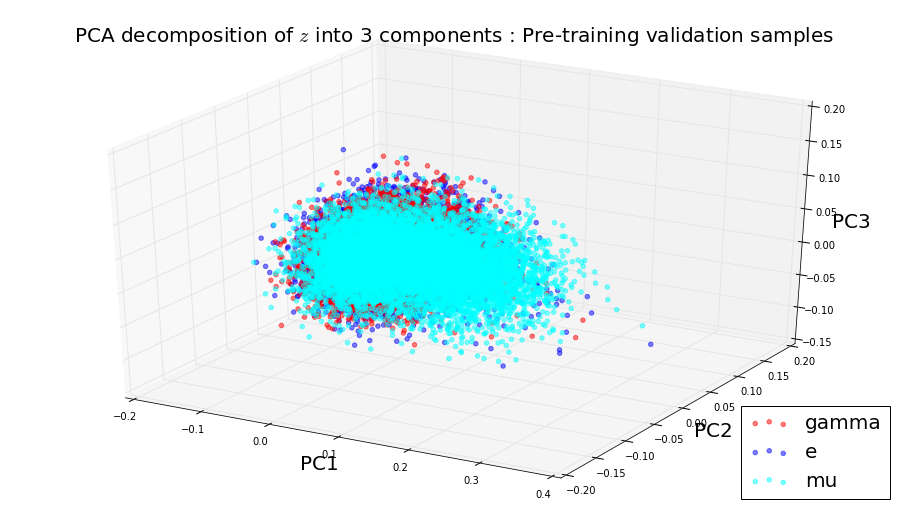

In [47]:
# Using 2 principle components
pca_pre_valid_3 = PCA(n_components=3)
pre_valid_npz_latent = pre_valid_npz['latents']
pre_valid_npz_latent = pca_pre_valid_3.fit_transform(pre_valid_npz_latent)

print("Latents vector shape", pre_valid_npz['latents'].shape)
print("Principal components shape ", pre_valid_npz_latent.shape)

# Get the labels from the npz dict
pre_valid_npz_labels = pre_valid_npz['labels']
print("Labels vector shape ", pre_valid_npz_labels.shape)

# Initialize the plot and corresponding parameters
fig = plt.figure(figsize=(16,9),facecolor="w")
ax = fig.add_subplot(111, projection='3d')

ax.tick_params(labelsize=10)

colors = ["red", "blue", "cyan"]

for i in range(len(colors)):
    curr_event_latents = pre_valid_npz_latent[pre_valid_npz_labels == i]
    ax.scatter(curr_event_latents[:,0], curr_event_latents[:,1], curr_event_latents[:,2],
                color=colors[i], label=label_dict[i], alpha=0.5)

# Setup the axes
ax.set_xlabel("PC1", fontsize=20)
ax.set_ylabel("PC2", fontsize=20)
ax.set_zlabel("PC3", fontsize=20)

plt.legend(loc="lower right", prop={"size":20})
plt.title(r"PCA decomposition of $z$ into 3 components : Pre-training validation samples"
          ,fontsize=20)

plt.show()

Latents vector shape (30000, 64)
Principal components shape  (30000, 3)
Labels vector shape  (30000,)


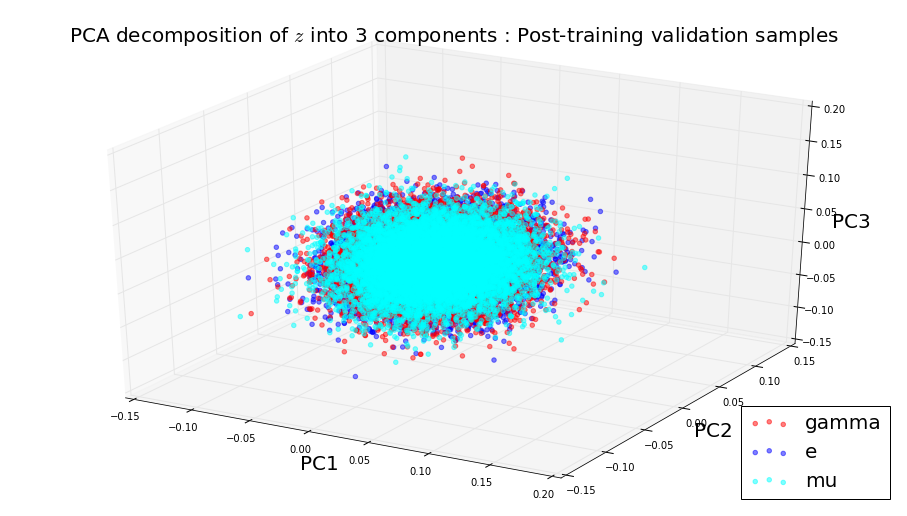

In [51]:
# Using 3 principle components
pca_post_valid_3 = PCA(n_components=3)
post_valid_npz_latent = post_valid_npz['latents']
post_valid_npz_latent = pca_post_valid_3.fit_transform(post_valid_npz_latent)

print("Latents vector shape", post_valid_npz['latents'].shape)
print("Principal components shape ", post_valid_npz_latent.shape)

# Get the labels from the npz dict
post_valid_npz_labels = post_valid_npz['labels']
print("Labels vector shape ", post_valid_npz_labels.shape)

# Initialize the plot and corresponding parameters
fig = plt.figure(figsize=(16,9),facecolor="w")
ax = fig.add_subplot(111, projection='3d')

ax.tick_params(labelsize=10)

colors = ["red", "blue", "cyan"]

for i in range(len(colors)):
    curr_event_latents = post_valid_npz_latent[post_valid_npz_labels == i]
    ax.scatter(curr_event_latents[:,0], curr_event_latents[:,1], curr_event_latents[:,2],
                color=colors[i], label=label_dict[i], alpha=0.5)

# Setup the axes
ax.set_xlabel("PC1", fontsize=20)
ax.set_ylabel("PC2", fontsize=20)
ax.set_zlabel("PC3", fontsize=20)

plt.legend(loc="lower right", prop={"size":20})
plt.title(r"PCA decomposition of $z$ into 3 components : Post-training validation samples"
          ,fontsize=20)

plt.show()